In [1]:
# Load a random sample of speeches pronounced in the floor of the US Congress between 1994 and 2024
import pandas as pd
df = pd.read_csv('../data/us_congress_speeches_sample.csv')
df['year'] = pd.to_datetime(df['date']).dt.year

print("Number of speeches: {}".format(len(df)))
df.head()

Number of speeches: 28731


,date,text,speaker_bioguide,chamber,party,doc_clean,year
0,2003-06-10,"Mr. ISRAEL. Mr. Speaker, I rise today to com...",I000057,House,Democrat,commend induction successful wrestling coach h...,2003
1,2012-05-08,"Mr. LANGEVIN. Mr. Speaker, Democrats are com...",L000559,House,Democrat,commit reduce deficit balanced way contrast br...,2012
2,2010-03-25,"Mr. BISHOP of Utah. Mr. Speaker, Lori Garver...",B001250,House,Republican,number administrator political give credit pri...,2010
3,1995-01-25,"Mr. KIM. Mr. Chairman, I rise today in suppo...",K000181,House,Republican,balanced budget small business tough run small...,1995
4,2003-05-22,"Mr. BAUCUS. Mr. President, sometime in the n...",B000243,Senate,Democrat,near future eye beholder go conference tax cut...,2003


In [2]:
# Build GTMCorpus()

import sys
sys.path.append('../src/')

from corpus import Corpus
from models import GTM
from sklearn.feature_extraction.text import CountVectorizer

# 1. Define and fit the vectorizer using training data 
vectorizer = CountVectorizer(
    ngram_range=(1, 1),
    max_df=0.95,
    min_df=0.0001,
    stop_words="english",
    token_pattern=r"(?u)\b\w{3,}\b"  # only words with 3 or more letters
)

vectorizer.fit(df["doc_clean"])  

print("Number of words in the vocabulary: {}".format(len(vectorizer.get_feature_names_out())))

# 2. Define modalities using the external vectorizer 
modalities = {
    "text": {
        "column": "doc_clean",
        "views": {
            "bow": {
                "type": "bow",
                "vectorizer": vectorizer
            }
        }
    }
}

# 3. Create GTMCorpus with prevalence and content covariates
# Setting to None simply trains a Wasserstein topic model (without metadata).
train_dataset = Corpus(
    df=df,
    modalities=modalities,
    prevalence="~ C(party) + C(chamber) + C(year)",
    content="~ C(party) + C(chamber) + C(year)"
)

Number of words in the vocabulary: 14355


In [3]:
encoder_args = {
    "text_bow": {
        "hidden_dims": [256,64],
        "activation": "relu",
        "bias": True,
        "dropout": 0.2
    }
}

decoder_args = {
    "text_bow": {
        "hidden_dims": [64,256],
        "activation": "relu",
        "bias": True,
        "dropout": 0.2
    }
}

In [4]:
# Train the model
# With initialization = True, the model first learns topics keeping the prior fixed for several epochs, and then updates the prior.
# Initialization may take a few minutes (the model stops the initialization routine as soon as the training loss stops improving).
tm = GTM(
    train_dataset, 
    n_topics=20,
    doc_topic_prior="dirichlet",
    update_prior=True,
    initialization=True,
    encoder_args=encoder_args,
    decoder_args=decoder_args,
    w_prior=1,
    patience=1
)

Initializing model...
Initialization completed in 27 epochs.

Epoch   1	Mean Training Loss:7.8365701


Epoch   2	Mean Training Loss:7.8247766


Epoch   3	Mean Training Loss:7.8155955


Epoch   4	Mean Training Loss:7.8147761


Epoch   5	Mean Training Loss:7.8203140


Stopping at Epoch 5. Reverting to Epoch 4


In [5]:
print(
    "\n".join(
        [
            "{}: {}".format(str(k), str(v))
            for k, v in tm.get_topic_words(topK=5).items()
        ]
    )
)

Topic_0: ['right', 'war', 'government', 'world', 'military']
Topic_1: ['crime', 'drug', 'law', 'criminal', 'gun']
Topic_2: ['water', 'energy', 'land', 'use', 'oil']
Topic_3: ['law', 'case', 'legislation', 'court', 'right']
Topic_4: ['school', 'child', 'student', 'education', 'program']
Topic_5: ['health', 'disease', 'care', 'research', 'cancer']
Topic_6: ['legislation', 'provide', 'agency', 'section', 'provision']
Topic_7: ['majority', 'budget', 'leader', 'hour', 'come']
Topic_8: ['community', 'recognize', 'business', 'career', 'service']
Topic_9: ['life', 'man', 'family', 'day', 'war']
Topic_10: ['team', 'game', 'championship', 'season', 'win']
Topic_11: ['budget', 'cut', 'spending', 'debt', 'deficit']
Topic_12: ['right', 'law', 'judge', 'case', 'know']
Topic_13: ['insurance', 'employee', 'company', 'health', 'employer']
Topic_14: ['energy', 'oil', 'price', 'gas', 'use']
Topic_15: ['health', 'care', 'insurance', 'drug', 'coverage']
Topic_16: ['tax', 'cut', 'family', 'percent', 'pay']


In [6]:
print(
    "\n".join(
        [
            "{}: {}".format(str(k), str(v))
            for k, v in tm.get_covariate_words(topK=5).items()
        ]
    )
)

Intercept: ['program', 'community', 'provide', 'country', 'help']
C(party)[T.Independent]: ['program', 'provide', 'country', 'budget', 'help']
C(party)[T.Libertarian]: ['legislation', 'law', 'provide', 'important', 'government']
C(party)[T.Popular Democrat]: ['child', 'program', 'community', 'service', 'life']
C(party)[T.Republican]: ['program', 'money', 'help', 'provide', 'good']
C(chamber)[T.Senate]: ['program', 'help', 'provide', 'legislation', 'come']
C(year)[T.1995]: ['program', 'budget', 'cut', 'child', 'know']
C(year)[T.1996]: ['program', 'child', 'family', 'country', 'cut']
C(year)[T.1997]: ['child', 'program', 'family', 'country', 'provide']
C(year)[T.1998]: ['program', 'country', 'school', 'child', 'provide']
C(year)[T.1999]: ['program', 'provide', 'child', 'school', 'country']
C(year)[T.2000]: ['country', 'family', 'provide', 'tax', 'come']
C(year)[T.2001]: ['provide', 'program', 'family', 'country', 'help']
C(year)[T.2002]: ['country', 'provide', 'come', 'help', 'know']
C(y

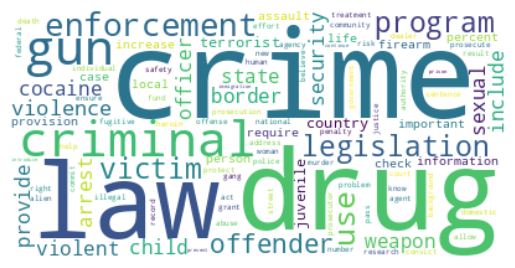

In [7]:
tm.plot_topic_word_distribution(topic_id=1, plot_type='wordcloud')

In [8]:
tm.visualize_docs(train_dataset)

In [9]:
# Effect of covariates on topic slant (content)
print("Top words per topic for a Democrat speaker:")
print(pd.DataFrame(tm.get_topic_words(l_content_covariates = ["Intercept"], topK=5)).T)

print("\nTop words per topic for a Republican speaker:")
print(pd.DataFrame(tm.get_topic_words(l_content_covariates = ["Intercept", "C(party)[T.Republican]"], topK=5)).T)

Top words per topic for a Democrat speaker:
                    0          1             2            3              4
Topic_0         peace      world    government        right  international
Topic_1         crime       drug      criminal          law            use
Topic_2         water       land        energy          use        project
Topic_3           law       case   legislation      provide          court
Topic_4        school    student         child    education        program
Topic_5       disease     health      research         care         cancer
Topic_6   legislation    provide     provision       agency        section
Topic_7      majority     budget          hour         know         leader
Topic_8     community  recognize      business       career           join
Topic_9          life        man           day       family            die
Topic_10         team       game  championship          win         season
Topic_11       budget        cut       deficit     spend